# Building an MLP Language Model
---

This is an extended version of Andrej Karpathy's notebook in addition to his [Zero To Hero](https://karpathy.ai/zero-to-hero.html) video on MLP language models.

Adapted by: 

Prof. Dr.-Ing. Antje Muntzinger, University of Applied Sciences Stuttgart

antje.muntzinger@hft-stuttgart.de

---

**NOTE:** You may answer in English or German.


# Table of Contents

[1. Text Generation with Multi-Layer-Perceptrons](#1.-Text-Generation-with-Multi-Layer-Perceptrons)

[2. Building the Dataset](#2.-Building-the-Dataset)

[3. Implementing the Neural Net](#3.-Implementing-the-Neural-Net)

[4. Training the MLP](#4.-Training-the-MLP)

[5. Training on Mini-Batches](#5.-Training-on-Mini-Batches)

[6. Tuning the Learning Rate](#6.-Tuning-the-Learning-Rate)

[7. Train-Valid-Test-Split](#7.-Train-Valid-Test-Split)

[8. Experiment: Larger Hidden Layer](#8.-Experiment:-Larger-Hidden-Layer)

[9. Visualization of the Embedding](#9.-Visualization-of-the-Embedding)

[10. Increasing the Embedding Dimension](#10.-Increasing-the-Embedding-Dimension)

[11. Final Evaluation and Sampling from the Model](#11.-Final-Evaluation-and-Sampling-from-the-Model)

[12. Challenge](#12.-Challenge)


## 1. Text Generation with Multi-Layer-Perceptrons

In the last notebook, we implemented a bigram language model in two versions: by counting the occurences of bigrams as well as by building a simple neural net with just a single layer. The problem with this approach is that if we are to take more context into account when predicting the next character in a sequence, things quickly blow up. For example, we had a 27x27 lookup table to predict the next token from the previous one. If we want to take the last 2 characters to predict the next, we already have a 27x27x27 lookup table, so the number of possible combinations grows exponentially with the length of the context. Therefore, we will explore a different approach here and implement a **Multi-Layer Perceptron (MLP)** following the 2003 paper
[A Neural Probabilistic Language Model](https://www.youtube.com/redirect?event=video_description&redir_token=QUFFLUhqbW9DTXY3aXpoa2doT1JXclNpUTZIS1h6V1RNd3xBQ3Jtc0tsdHZ6aUs3ck94TU5MVkNwSXpQd0VvLUdMRjVadmt1eGpLMXlCMGVTWWJqa1VobU13dXRxamNTa09aYk5hc2hoN0pEeHNMM2hSbFRBaVZBeVFUay1TRmFvRzBIaGhFb21QdHlIVzFzX09rd1NIWEVuSQ&q=https%3A%2F%2Fwww.jmlr.org%2Fpapers%2Fvolume3%2Fbengio03a%2Fbengio03a.pdf&v=TCH_1BHY58I) by Bengio et al. This was not the first paper applying an MLP to generate text, but it was very influential and is a nice write-up. In the paper, they used a word level language model with a vocabulary of 17 000 possible words. We will still use a character level language model, but follow the paper other than that. 

The idea of the paper is the following: To each word, a thirty dimensional feature vector is associated, so every word gets **embedded** into a thirty dimensional space. So we have 17 000 points or vectors in a 30 dimensional space (that's very crowded!) Now in the beginning these words are initialized randomly so they're spread out at random, but then we're going to tune these embeddings of the words using backpropagation. So during the training of this neural network, these vectors are going to move around and words that have  similar meanings or that are synonyms end up in a similar part of the space. Conversely, words with different meaning would go somewhere else in the space. Their modeling approach otherwise is identical to ours: They are using a multi-layer neural network to predict the next word given the previous words, and for training they are maximizing the log likelihood of the training data.

Why does this work? Suppose we want to complete the sentence 

    'A dog was running in a ...', 
    
which has never occured in the training data, so we are **out of distribution**.  But maybe the network has seen the sentence

    'The dog was running in a ...', 

and it has learned that 'a' and 'the' are frequently interchangeable, so it took the embeddings for 'a' and 'the' and put them nearby each other in the space. This is how the net can transfer knowledge through that embedding and generalize. Similarly, the network could know that cats and dogs are animals and they co-occur in lots of very similar contexts, and so even though you haven't seen this exact phrase, it can through the embedding space transfer knowledge and generalize to novel scenarios. Here is a nice visualization of embeddings (source: https://causewriter.ai/courses/ai-explainers/lessons/vector-embedding/):

<img src="img/embeddings.png" width="500">



Now let's take a closer look at the MLP:

<img src="img/MLP.jpg" width="600">

- *Input Layer:* Here, we are taking 3 previous words to predict the next word. The input is the index of the word, an integer between 0 and 16999 for 17 000 words. They use a lookup table C, a 17000x30 matrix, where every index is plucking out a row of this embedding matrix, so each index is converted to the 30 dimensional embedding vector for that word. The input layer consists of 30 neurons for three words making up 90 neurons in total. The matrix C is shared across all the words, so we're always indexing into the same matrix C over and over for each one of these words. 

- *Hidden Layer:* Then the data is processed to a hidden layer, where the size is a **hyperparameter** (a design choice up to the designer of the neural net), followed by a tanh nonlinearity. 

- *Output Layer:* Finally, the output layer consists of 17 000 neurons for all possible next words. So there are 17 000 logits followed by a softmax layer to calculate a probability distribution for the next word in the sequence. 

During training we have the label (=identity of the next word in a sequence), so we can pluck out the probability of that word and maximize the probability of that word with respect to the parameters of the neural net. The parameters that are optimized via backpropagation are the weights and biases of the output layer, the weights and biases of the hidden layer and the embedding lookup table C.

Now let's implement this network!

## 2. Building the Dataset

In [66]:
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt # for making figures
import random
%matplotlib inline

In [2]:
# read in all the words
words = open('names.txt', 'r').read().splitlines()
words[:8]

['emma', 'olivia', 'ava', 'isabella', 'sophia', 'charlotte', 'mia', 'amelia']

In [3]:
# build the vocabulary of characters and mappings to/from integers
chars = sorted(list(set(''.join(words))))
stoi = {s:i+1 for i,s in enumerate(chars)}
stoi['.'] = 0
itos = {i:s for s,i in stoi.items()}
print(itos)

{1: 'a', 2: 'b', 3: 'c', 4: 'd', 5: 'e', 6: 'f', 7: 'g', 8: 'h', 9: 'i', 10: 'j', 11: 'k', 12: 'l', 13: 'm', 14: 'n', 15: 'o', 16: 'p', 17: 'q', 18: 'r', 19: 's', 20: 't', 21: 'u', 22: 'v', 23: 'w', 24: 'x', 25: 'y', 26: 'z', 0: '.'}


We introduce the **block size** (or **context length**) parameter telling us how many characters we use to predict the next, here 3. We store the **context** (=3 consecutive characters) in X and the labels (=the next character) in Y:

In [4]:
# build the dataset

block_size = 3 # context length: how many characters do we take to predict the next one?

def build_dataset(words):
    X, Y = [], []
    for w in words:
    
        print(w)
        context = [0] * block_size # [0, 0, 0] (pad with zeros='.')
        for ch in w + '.':
            ix = stoi[ch]
            X.append(context) # input
            Y.append(ix) # labels
            print(''.join(itos[i] for i in context), '--->', itos[ix]) # 'emma' contains 5 training examples
            context = context[1:] + [ix] # crop and append (rolling window of context) e.g. [0, 0, 5], then [0, 5, 13]..
    
    X = torch.tensor(X)
    Y = torch.tensor(Y)
    print(X.shape, Y.shape)
    return X, Y


X, Y = build_dataset(words[:5]) # let's just work on a small dataset of 5 names for now

emma
... ---> e
..e ---> m
.em ---> m
emm ---> a
mma ---> .
olivia
... ---> o
..o ---> l
.ol ---> i
oli ---> v
liv ---> i
ivi ---> a
via ---> .
ava
... ---> a
..a ---> v
.av ---> a
ava ---> .
isabella
... ---> i
..i ---> s
.is ---> a
isa ---> b
sab ---> e
abe ---> l
bel ---> l
ell ---> a
lla ---> .
sophia
... ---> s
..s ---> o
.so ---> p
sop ---> h
oph ---> i
phi ---> a
hia ---> .
torch.Size([32, 3]) torch.Size([32])


In [5]:
X.shape, X.dtype, Y.shape, Y.dtype # we generated 32 training examples out of the 5 first words, each has 3 characters

(torch.Size([32, 3]), torch.int64, torch.Size([32]), torch.int64)

## 3. Implementing the Neural Net

Now let's build the *embedding table C*. In the paper, they have 17 000 words and they embed them in a comparably small 30 dimensional space. In our case, we have only 27 possible characters, so let's embed them in a comparably small space - let's start with a two-dimensional space:

In [6]:
g = torch.Generator().manual_seed(42) # for reproducibility
C = torch.randn((27, 2), generator=g)

We visualize the 2D embeddings of all characters (which are untrained yet, just randomly initialized). Remember that they start anywhere in embedding space and move around during training, clustering in some meaningful way.

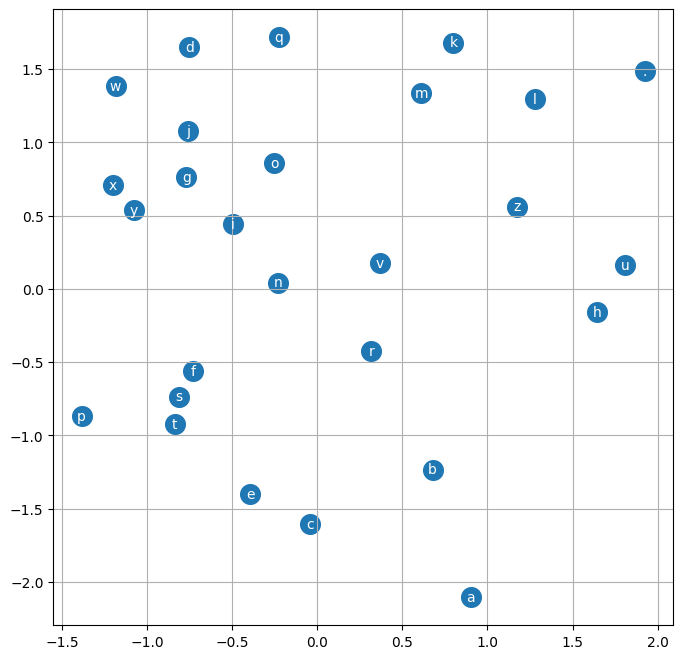

In [9]:
# visualize dimensions 0 and 1 of the embedding matrix C for all characters
plt.figure(figsize=(8,8))
plt.scatter(C[:,0].data, C[:,1].data, s=200)
for i in range(C.shape[0]):
    plt.text(C[i,0].item(), C[i,1].item(), itos[i], ha="center", va="center", color='white')
plt.grid('minor')

There are two methods to pluck out the 5th row:

Option 1 - Directly plucking the embeddings from C:

In [10]:
C[5]

tensor([-0.3925, -1.4036])

Option 2 - Calculating the one-hot encoding of 5 and multiplying it with the embedding matrix:

In [11]:
F.one_hot(torch.tensor([5]), num_classes=27)

tensor([[0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0]])

In [12]:
F.one_hot(torch.tensor([5]), num_classes=27).float() @ C # note that we need to convert the one-hot to float from int to match the type of C

tensor([[-0.3925, -1.4036]])

Therefore, we can either think of the embedding as an integer indexing into a lookup table C, or as a first layer of the neural net with weight matrix C (without nonlinearity), where we encode integers into one-hot vectors and feed them in. Here, we are going to use the first interpretation with indexing because it is faster. But how can we simultaneously index all 32x3 integers stored in X? Luckily, we can also index with a list or tensor in PyTorch:

In [13]:
C[[4,4,5]], C[torch.tensor([4,4,5])] # indexing with a list or tensor of indices

(tensor([[-0.7521,  1.6487],
         [-0.7521,  1.6487],
         [-0.3925, -1.4036]]),
 tensor([[-0.7521,  1.6487],
         [-0.7521,  1.6487],
         [-0.3925, -1.4036]]))

In [13]:
X[13,2], C[X][13,2], C[1] # another example for indexing

(tensor(1), tensor([ 0.9007, -2.1055]), tensor([ 0.9007, -2.1055]))

In [14]:
emb = C[X] # we can even directly use the tensor X to index into C
emb.shape # shape of the embeddings - we need to flatten them for the hidden layer

torch.Size([32, 3, 2])

**TODO (optional):** Why is the shape of the embedding 32x3x2?

**ANSWER:** 
We have a 32 data with block size 3. In each data the block has 3 words(which means 3 index) and each word has a representation sized 1x2 in embedding table C. Thus, we have 32 row of data, each data has 3 word and each word has 2 value for representation.

Here is a visualization of our embedding of input '.em' (actually 3 embeddings, each token plucks out the corresponding row of C independently):

<img src="img/MLP1.jpg" width="400">


Now let's implement the *hidden layer* of size 100 (a design choice). We start by initializing weights and biases:

In [15]:
W1 = torch.randn((6, 100)) # 6 = block_size * emb_dim = 3 * 2, 100 = hidden size (design choice)
b1 = torch.randn(100) # bias for the hidden layer

We calculate the weighted sum (**logits**) and apply the **tanh() activation**: 

In [19]:
logits = emb.view(-1, 6) @ W1 + b1 # reshaping the embeddings to (batch_size, block_size * emb_dim) and applying the linear layer

In [20]:
h = torch.tanh(logits) # apply tanh activation

In [21]:
h

tensor([[-0.9965, -0.9740,  0.3373,  ..., -0.9954,  0.1514,  0.9998],
        [ 0.9999, -0.6383, -0.0060,  ..., -0.8360,  0.9986,  0.9993],
        [-1.0000, -0.9145, -0.9977,  ..., -0.9995, -0.6100,  0.9503],
        ...,
        [ 0.7551,  0.6666,  0.3281,  ..., -1.0000,  0.2266,  0.5752],
        [ 0.9890, -0.9933, -0.1906,  ...,  0.9999, -0.6375, -0.9647],
        [ 1.0000, -0.7389, -0.6681,  ..., -0.9961,  0.9776,  0.9987]])

In [22]:
h.shape

torch.Size([32, 100])

Here is a visualization of our hidden layer after flattening the embedding:

<img src="img/MLP2.jpg" width="700">

And the *output layer*:

In [23]:
W2 = torch.randn((100, 27)) # 100 = hidden size, 27 = vocab size
b2 = torch.randn(27)

**TODO:** 3a) Calculate the logits (weighted sum) with input `h`, weights `W2` and bias `b2`. Store the result in `logits`. What is the shape of the output and why? **(3 points)**

In [ ]:
# YOUR CODE GOES HERE
logits = h @ W2 + b2 # ((32,100)x(100,27) + (27))
print("Logits:", logits)
print("Shape of logits:", logits.shape)


torch.Size([32, 27])

**ANSWER:** 
Because in hidden layer we have 32 data and for each data we have 100D representation,and we have W with shape (100,27). When we multiply our new input layer with weights (32,100)x(100,27), the output layer would be in shape (32,27) and adding bias is a scalar operation which doesnt change the shape of the output layer.

**TODO:** 3b) Calculate the counts by exponentating the logits and store the result in `counts`, then normalize to get probabilities and store the result in `prob`. **(2 points)** 

**HINT:** Remember the bigram model!

In [25]:
# YOUR CODE GOES HERE
counts = torch.exp(logits)
prob = counts / counts.sum(dim=1, keepdims=True)


This is a visualization of our complete MLP:

<img src="img/MLP3.jpg" width="800">

Finally we calculate the cross entropy loss:

In [26]:
loss = -prob[torch.arange(len(Y)), Y].log().mean() # cross-entropy loss
loss

tensor(13.9634)

## 4. Training the MLP

Let's summarize the code so far and train the network! We summarize all trainable parameters in a list called `parameters`:

In [27]:
g = torch.Generator().manual_seed(42) # for reproducibility
C = torch.randn((27, 2), generator=g)
W1 = torch.randn((6, 100), generator=g)
b1 = torch.randn(100, generator=g)
W2 = torch.randn((100, 27), generator=g)
b2 = torch.randn(27, generator=g)
parameters = [C, W1, b1, W2, b2] # cluster all parameters in one list for counting the number of parameters

In [28]:
sum(p.nelement() for p in parameters) # number of parameters in total

3481

In [29]:
for p in parameters:
    p.requires_grad = True 

**TODO:** 4a) Research why we need to set `requires_grad = True`, e.g. in the PyTorch documentation! **(1 point)** 

**ANSWER:** 
requires_grad attribute determines whether or not the computation of gradients is enabled for each parameter p during backpropagation.
When p.requires_grad = True, it tells PyTorch to track all operations on the parameter p so that gradients can be calculated during backpropagation. \
\
\
PyTorch:(requires_grad is a flag, defaulting to false unless wrapped in a nn.Parameter, that allows for fine-grained exclusion of subgraphs from gradient computation. It takes effect in both the forward and backward passes:
During the forward pass, an operation is only recorded in the backward graph if at least one of its input tensors require grad. During the backward pass (.backward()), only leaf tensors with requires_grad=True will have gradients accumulated into their .grad fields.)

**TODO:** 4b) In the code block below, try to understand what each line of code does, and comment each line! **(3 points)**

In [ ]:
# YOUR COMMENTS GO HERE

niter = 1000 #number of iterations

for i in range(niter): 

    # forward pass
    emb = C[X] # for each iteration create an embedding layer for all blocks
    h = torch.tanh(emb.view(-1, 6) @ W1 + b1) # flatten it, calculate weighted sum and by using tanh activation function,calculate the values for the hidden layer
    logits = h @ W2 + b2 # by using the hidden layer as an input, now  calculate a weighted sum for the output layer
    loss = F.cross_entropy(logits, Y) # calculate the loss
    
    # backward pass
    for p in parameters: 
        p.grad = None # clears the gradients of the model's parameters, removes any gradient values left over from the previous training step. 
    loss.backward()  # computes the gradient of the loss function with respect to each parameter through backpropagation
    
    # update
    for p in parameters: 
        p.data += -0.1 * p.grad # updates each parameter by subtracting calculated gradients values with 0.1 learning rate

    print(loss.item()) # gets the loss tensor values

0.2543293535709381
0.25432640314102173
0.25432348251342773
0.2543206214904785
0.2543177008628845
0.2543148398399353
0.2543119490146637
0.2543090879917145
0.25430622696876526
0.25430336594581604
0.25430047512054443
0.2542976140975952
0.2542947828769684
0.25429195165634155
0.2542891204357147
0.2542862892150879
0.25428345799446106
0.254280686378479
0.2542778551578522
0.25427502393722534
0.2542722225189209
0.25426948070526123
0.2542666494846344
0.25426381826400757
0.2542610764503479
0.25425833463668823
0.2542555630207062
0.25425276160240173
0.25425004959106445
0.2542472779750824
0.2542445659637451
0.25424182415008545
0.254239022731781
0.25423628091812134
0.25423359870910645
0.2542308568954468
0.2542281746864319
0.2542254626750946
0.25422272086143494
0.25422000885009766
0.25421732664108276
0.2542146146297455
0.25421199202537537
0.2542092800140381
0.2542066276073456
0.2542039453983307
0.2542012929916382
0.2541986405849457
0.2541959881782532
0.2541933059692383
0.2541906535625458
0.25418803095

**TODO:** 4c) Can you interpret the loss - why is it so small? **(2 points)**

**HINT:** Is a small training loss always a good sign, or should we consider other factors as well?

**ANSWER:**   As the training data is very small, the model might overfit. We shouldn't just consier the training loss, we should remember that the model might overfit because of small data, too many parameters or too coplex model.

**TODO:** 4d) Can we reach a loss of exactly 0 when continuing optimization? Why or why not? **(2 points)**

**ANSWER:** I don't think so because weights are optimized for all inputs. If we continuie optimizationg loss might get lower but the will be always some probability values for other classes.

Summing all steps in a visualization, including cross entropy loss calculation:


<img src="img/MLP4.jpg" width="900">

---

## 5. Training on Mini-Batches

**TODO:** 5a) Read in the whole dataset for training instead of the first 5 words and store the inputs and labels in X and Y again! How many training examples do we have now roughly? **(2 points)** 

**HINT:** Use the `build_dataset()` function defined above!

In [38]:
# YOUR CODE GOES HERE
X,Y = build_dataset(words)


emma
... ---> e
..e ---> m
.em ---> m
emm ---> a
mma ---> .
olivia
... ---> o
..o ---> l
.ol ---> i
oli ---> v
liv ---> i
ivi ---> a
via ---> .
ava
... ---> a
..a ---> v
.av ---> a
ava ---> .
isabella
... ---> i
..i ---> s
.is ---> a
isa ---> b
sab ---> e
abe ---> l
bel ---> l
ell ---> a
lla ---> .
sophia
... ---> s
..s ---> o
.so ---> p
sop ---> h
oph ---> i
phi ---> a
hia ---> .
charlotte
... ---> c
..c ---> h
.ch ---> a
cha ---> r
har ---> l
arl ---> o
rlo ---> t
lot ---> t
ott ---> e
tte ---> .
mia
... ---> m
..m ---> i
.mi ---> a
mia ---> .
amelia
... ---> a
..a ---> m
.am ---> e
ame ---> l
mel ---> i
eli ---> a
lia ---> .
harper
... ---> h
..h ---> a
.ha ---> r
har ---> p
arp ---> e
rpe ---> r
per ---> .
evelyn
... ---> e
..e ---> v
.ev ---> e
eve ---> l
vel ---> y
ely ---> n
lyn ---> .
abigail
... ---> a
..a ---> b
.ab ---> i
abi ---> g
big ---> a
iga ---> i
gai ---> l
ail ---> .
emily
... ---> e
..e ---> m
.em ---> i
emi ---> l
mil ---> y
ily ---> .
elizabeth
... ---> e
..e ---

**ANSWER:** 228146

In practice, it is too computationally expensive to forward and backward pass the whole training set at once. Instead, we use **mini-batches** of e.g. 32 randomly chosen examples processed in parallel. The quality of the gradient might be a little lower because we are not using all data, the direction of the gradient is not the exact actual direction, but it is good enough and we can simply calculate more steps to compensate this.   

We can use `randint` for random sampling of the batch examples. Like this, we sample 32 random row indices of X (wicht is now of shape 228146 x 3):

In [39]:
torch.randint(0, X.shape[0], (32,)) # example of sampling from a uniform distribution (low, high, shape)

tensor([124462,  66724,  91991,  77181,  49314,  21552,  53814,  59493, 195852,
         56529, 221281,  53655,   3725,  19604,  10860,  85543,  19403, 182330,
        174515, 185882, 104490,  95995, 176678, 166634,  22353, 182554, 174699,
         25143, 100972, 161863,  19708,  59238])

This is the training loop with random mini-batches of size 32:

In [40]:
niter = 1000 # number of iterations

for i in range(niter):
    
    # minibatch construct
    ix = torch.randint(0, X.shape[0], (32,))
    
    # forward pass
    emb = C[X[ix]] # (32, 3, 10)? 32,3,2
    h = torch.tanh(emb.view(-1, 6) @ W1 + b1) # (32, 200) ? 32,100
    logits = h @ W2 + b2 # (32, 27)
    loss = F.cross_entropy(logits, Y[ix]) # instead of the manual computation above (more efficient and numerically stable)
    print(loss.item())
    
    # backward pass
    for p in parameters:
        p.grad = None # reset the gradients
    loss.backward() # compute the gradients
    
    # update
    for p in parameters:
        p.data += -0.1 * p.grad

11.817964553833008
15.0540771484375
12.217272758483887
11.275863647460938
10.640242576599121
12.738526344299316
8.68908977508545
10.38184928894043
8.389653205871582
7.602630615234375
6.7361907958984375
8.529590606689453
8.970464706420898
8.598519325256348
10.141472816467285
8.634112358093262
7.56351375579834
8.157386779785156
6.974088191986084
7.911402225494385
7.390013217926025
8.90407657623291
5.741984844207764
8.822816848754883
7.260072708129883
7.015707969665527
5.605555534362793
7.489266872406006
8.311169624328613
7.311720848083496
6.023444175720215
7.663660049438477
4.692578315734863
6.8633928298950195
8.476725578308105
6.789677143096924
7.820145130157471
4.203566074371338
6.338825225830078
5.303079128265381
3.741575002670288
7.475760459899902
5.695481300354004
4.67080020904541
6.78039026260376
6.324392795562744
4.393774032592773
5.482503890991211
4.621811866760254
4.507805824279785
4.972095966339111
5.702224254608154
5.391458988189697
6.922913551330566
5.0661749839782715
4.68610

## 6. Tuning the Learning Rate

The code blocks below summarize the code so far. For repeated execution, we write a function `trainloop()` that can be called with different numbers of iterations, learning rates etc:

In [41]:
# reset the parameters
g = torch.Generator().manual_seed(42) # for reproducibility
C = torch.randn((27, 2), generator=g)
W1 = torch.randn((6, 100), generator=g)
b1 = torch.randn(100, generator=g)
W2 = torch.randn((100, 27), generator=g)
b2 = torch.randn(27, generator=g)
parameters = [C, W1, b1, W2, b2] # cluster all parameters in one list for counting the number of parameters

for p in parameters:
    p.requires_grad = True # we want to learn the parameters
    

In [ ]:
# define the training loop as a function
def trainloop(niter, X, Y, parameters, lrs, output=True, emb_dim=2, context_length=3):  

    # keep track of the losses and steps
    lossi = []  
    stepi = []
    
    for i in range(niter):
        
        # minibatch construct
        ix = torch.randint(0, X.shape[0], (32,))
        
        # forward pass
        emb = C[X[ix]] # (32, 3, 10)? 2
        h = torch.tanh(emb.view(-1, emb_dim*context_length) @ W1 + b1) # (32, 200)
        logits = h @ W2 + b2 # (32, 27)
        loss = F.cross_entropy(logits, Y[ix]) # instead of the manual computation above (more efficient and numerically stable)
        if output:
            print(loss.item())
        
        # backward pass
        for p in parameters:
            p.grad = None # reset the gradients
        loss.backward() # compute the gradients
        
        # update
        lr = lrs[i]
        for p in parameters:
            p.data += -lr * p.grad

        # track stats
        stepi.append(i)
        lossi.append(loss.log10().item())

    return parameters, stepi, lossi

In [43]:
# define the hyperparameters and run the training loop
niter = 1000 # number of iterations

lrs = torch.full((niter,), 0.1) # learning rates = tensor of constant values (0.1) for all iterations

parameters, stepi, lossi = trainloop(niter, X, Y, parameters, lrs) # run the training loop

14.309460639953613
15.128777503967285
13.227858543395996
14.774096488952637
14.511670112609863
10.681774139404297
14.821218490600586
11.574196815490723
11.58834171295166
10.251200675964355
8.11886978149414
9.938599586486816
10.27158260345459
9.68848991394043
10.203018188476562
8.18154239654541
7.160725116729736
10.023916244506836
9.100542068481445
7.004408359527588
8.342314720153809
7.4359307289123535
9.208948135375977
7.783371448516846
8.467170715332031
6.394231796264648
7.729205131530762
7.9507155418396
6.198668956756592
8.292095184326172
5.221543788909912
6.54394006729126
5.356481075286865
7.109286308288574
8.7334623336792
4.214944362640381
5.751483917236328
5.007312774658203
7.23497200012207
5.233541965484619
6.779696464538574
7.081640720367432
4.472394943237305
6.411996364593506
5.7836761474609375
4.638587474822998
5.570545196533203
6.057836532592773
3.921400785446167
5.603209018707275
4.300205707550049
4.663679599761963
5.431575298309326
6.668571949005127
5.1869659423828125
5.151

**TODO:** 6a) Experiment with different learning rates. Don't forget to reset the parameters first! Which learning rate seems to work best? Which learning rates are too high or too low? **(3 points)**

In [57]:
# YOUR EXPERIMENTS HERE
# reset the parameters
g = torch.Generator().manual_seed(42) # for reproducibility
C = torch.randn((27, 2), generator=g)
W1 = torch.randn((6, 100), generator=g)
b1 = torch.randn(100, generator=g)
W2 = torch.randn((100, 27), generator=g)
b2 = torch.randn(27, generator=g)
parameters = [C, W1, b1, W2, b2] # cluster all parameters in one list for counting the number of parameters

for p in parameters:
    p.requires_grad = True # we want to learn the parameters

lrs = torch.full((niter,), 1)
parameters, stepi, lossi = trainloop(niter, X, Y, parameters, lrs)

17.423093795776367
14.427461624145508
13.096424102783203
12.913241386413574
13.342780113220215
14.487154006958008
13.95152759552002
13.040325164794922
9.39167308807373
10.483173370361328
12.60017204284668
9.996390342712402
9.261054992675781
9.578975677490234
7.652963161468506
8.579315185546875
8.940949440002441
10.841575622558594
6.832314491271973
7.361060619354248
10.933034896850586
12.345869064331055
8.927346229553223
9.095429420471191
11.748806953430176
7.709986209869385
10.631566047668457
8.250099182128906
8.945619583129883
7.879637241363525
9.246880531311035
8.072468757629395
8.443230628967285
9.92041015625
10.675132751464844
8.721761703491211
10.120767593383789
10.033188819885254
13.042811393737793
9.100716590881348
9.91062068939209
6.0810651779174805
8.72218132019043
9.36467456817627
7.223074913024902
6.241483211517334
9.173016548156738
10.374543190002441
8.815728187561035
7.916898727416992
11.249407768249512
9.14813232421875
6.074348449707031
7.255233287811279
7.346551418304443

In [54]:
# YOUR EXPERIMENTS HERE
# reset the parameters
g = torch.Generator().manual_seed(42) # for reproducibility
C = torch.randn((27, 2), generator=g)
W1 = torch.randn((6, 100), generator=g)
b1 = torch.randn(100, generator=g)
W2 = torch.randn((100, 27), generator=g)
b2 = torch.randn(27, generator=g)
parameters = [C, W1, b1, W2, b2] # cluster all parameters in one list for counting the number of parameters

for p in parameters:
    p.requires_grad = True # we want to learn the parameters

lrs = torch.full((niter,), 0.001)
parameters, stepi, lossi = trainloop(niter, X, Y, parameters, lrs)


15.769102096557617
16.595735549926758
17.051345825195312
16.933727264404297
15.918800354003906
14.722271919250488
14.276458740234375
17.27165412902832
16.072465896606445
14.240031242370605
17.5557861328125
17.910606384277344
17.229515075683594
17.507709503173828
17.976560592651367
18.43541145324707
13.922172546386719
15.969106674194336
18.988540649414062
15.485562324523926
13.907673835754395
15.970961570739746
13.688870429992676
14.286121368408203
17.744985580444336
16.23113441467285
15.585834503173828
14.69852066040039
15.280301094055176
18.066713333129883
13.650676727294922
17.33704376220703
16.40706443786621
18.083728790283203
14.89628791809082
17.096017837524414
17.382247924804688
16.960865020751953
15.423413276672363
15.25113296508789
17.10911750793457
17.458589553833008
15.426557540893555
17.370012283325195
12.507648468017578
14.42879867553711
16.076709747314453
16.041847229003906
14.287875175476074
17.281797409057617
15.310286521911621
14.173565864562988
13.07732105255127
14.877

In [52]:
# YOUR EXPERIMENTS HERE
# reset the parameters
g = torch.Generator().manual_seed(42) # for reproducibility
C = torch.randn((27, 2), generator=g)
W1 = torch.randn((6, 100), generator=g)
b1 = torch.randn(100, generator=g)
W2 = torch.randn((100, 27), generator=g)
b2 = torch.randn(27, generator=g)
parameters = [C, W1, b1, W2, b2] # cluster all parameters in one list for counting the number of parameters

for p in parameters:
    p.requires_grad = True # we want to learn the parameters

lrs = torch.full((niter,), 0.09)
parameters, stepi, lossi = trainloop(niter, X, Y, parameters, lrs)

16.83282470703125
14.906922340393066
15.397502899169922
13.518346786499023
11.590278625488281
10.519431114196777
11.753613471984863
10.512386322021484
9.562803268432617
12.715516090393066
11.604438781738281
10.681382179260254
10.645214080810547
12.337740898132324
9.538033485412598
8.394135475158691
8.41714859008789
8.760612487792969
8.017160415649414
8.084452629089355
5.871314525604248
6.856204509735107
8.063322067260742
6.786555290222168
8.143904685974121
9.509012222290039
7.0056257247924805
7.096872329711914
7.820165634155273
7.3671040534973145
8.952447891235352
9.00467586517334
5.225694179534912
6.954275131225586
5.92742919921875
7.941349983215332
8.724693298339844
6.541697025299072
5.400089263916016
6.022223949432373
6.215933799743652
7.025972843170166
5.952916145324707
6.415343284606934
6.309102535247803
5.639009475708008
5.863775253295898
7.330105304718018
6.234537601470947
5.045408725738525
4.628042221069336
4.586472988128662
5.422378063201904
5.6441264152526855
6.67859220504760

**ANSWER:** 1 or higher learning rates are too large,model probably missed the local minima. 0.01 or lower rates are too small, model probably couldn't reach the local minima in niter step. 

We can make the search more systematic using **grid search** techniques:

In [58]:
# systematically test different learning rates (logarithmically spaced between 1e-3 and 1)
lre = torch.linspace(-3, 0, 1000) # lre = learning rate exponent = log10(learning rate)
lrs = 10**lre

In [59]:
# reset the parameters
g = torch.Generator().manual_seed(42) # for reproducibility
C = torch.randn((27, 2), generator=g)
W1 = torch.randn((6, 100), generator=g)
b1 = torch.randn(100, generator=g)
W2 = torch.randn((100, 27), generator=g)
b2 = torch.randn(27, generator=g)
parameters = [C, W1, b1, W2, b2] # cluster all parameters in one list

for p in parameters:
    p.requires_grad = True # we want to learn the parameters
    

parameters, stepi, lossi = trainloop(niter, X, Y, parameters, lrs) # run the training loop

16.26936149597168
16.751903533935547
17.748943328857422
16.865978240966797
15.313141822814941
16.181167602539062
15.889630317687988
15.987388610839844
14.092333793640137
16.260940551757812
16.277198791503906
17.171783447265625
15.730738639831543
18.388757705688477
15.520737648010254
14.71660041809082
14.80471420288086
13.7315034866333
19.015140533447266
16.954326629638672
16.182418823242188
14.066853523254395
16.493736267089844
17.8972110748291
17.065624237060547
14.796337127685547
15.31498908996582
13.766451835632324
15.4735746383667
15.84778881072998
15.241815567016602
16.51285743713379
17.692405700683594
16.799694061279297
15.631163597106934
15.949665069580078
16.04664421081543
19.30794334411621
15.51268196105957
18.987829208374023
15.862895965576172
12.76580810546875
14.115776062011719
10.837777137756348
16.344980239868164
16.810379028320312
16.687868118286133
16.845853805541992
15.217167854309082
17.390727996826172
17.247926712036133
16.538732528686523
14.985241889953613
13.134942

**TODO:** 6b) Plot the loss over the different learning rate exponents. Which learning rate should we use? **(2 points)**

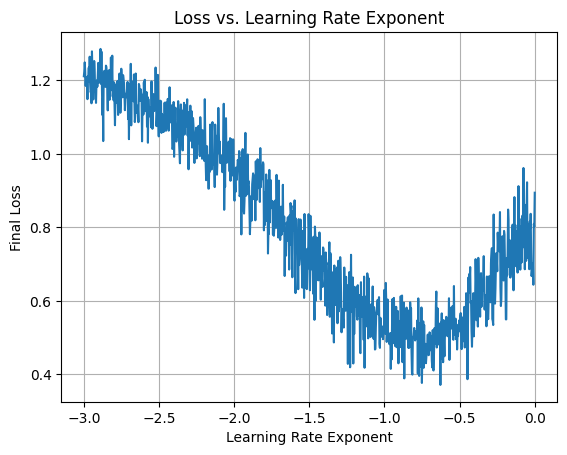

In [62]:
# YOUR CODE GOES HERE
plt.plot(lre, lossi)
plt.xlabel('Learning Rate Exponent')
plt.ylabel('Final Loss')
plt.title('Loss vs. Learning Rate Exponent')
plt.grid(True)
plt.show()

**ANSWER:** -0.75 learning rate exponent looks the best option. Which means: 10**(-0.75)=0.177 learning rate

Now that we have found a good learning rate, let's only do one step of **learning rate decay** and run for a very long time. This is how you would roughly proceed in production as well: Find a good learning rate via grid search, train with it until the loss reaches a plateau, then decrease the learning rate some more and see if the loss goes down again. 

In [63]:
# reset the parameters
g = torch.Generator().manual_seed(42) # for reproducibility
C = torch.randn((27, 2), generator=g)
W1 = torch.randn((6, 100), generator=g)
b1 = torch.randn(100, generator=g)
W2 = torch.randn((100, 27), generator=g)
b2 = torch.randn(27, generator=g)
parameters = [C, W1, b1, W2, b2] # cluster all parameters in one list for counting the number of parameters

for p in parameters:
    p.requires_grad = True # we want to learn the parameters

In [64]:
niter = 100000 # number of iterations

lrs = torch.full((niter,), 0.1) # learning rates = tensor of constant values (0.1) for the first 50 000 iterations
lrs[50000:] = 0.01 # learning rates = tensor of constant values (0.01) for the remaining 50 000 iterations

parameters, stepi, lossi = trainloop(niter, X, Y, parameters, lrs, output=False) # run the training loop

In [65]:
# evaluate loss
emb = C[X] # (32, 3, 2)
h = torch.tanh(emb.view(-1, 6) @ W1 + b1) # (32, 100)
logits = h @ W2 + b2 # (32, 27)
loss = F.cross_entropy(logits, Y)
loss

tensor(2.2882, grad_fn=<NllLossBackward0>)

We see that the loss is at 2.29, which is already better than the bigram model from the last notebook, which was 2.45! 

...except that this is not exactly true: The loss on the training data could become very small only due to overfitting. The model could only memorize the training data and perform very good on these, but poorly once you test it with new data. Therefore, the data is usually split in 3 parts: The **training data** (e.g. 80%) is used for parameter optimization like we did above using gradient descent. The **validation data** or **dev data** (e.g. 10%) is used for tuning hyperparameters (e.g. size of the hidden layer, size of the embedding, learning rate...) and the **test data set** (e.g. 10%) is kept aside to measure the final performance and generalization capabilities of the model. The test set should only be used once because each time you evaluate on the test set and learn something from it, you basically train on the test set, so you also risk overfitting to your test set and will not be able to measure generalization capabilities anymore. So let's implement this:

## 7. Train-Valid-Test-Split

**TODO:** 7a) Split the data in 80% training data stored in `Xtr`, `Ytr`, 10% dev data stored in `Xdev`, `Ydev` and 10% test data stored in `Xte`, `Yte`. Don't forget to randomly shuffle the words first. **(3 points)**

**HINT:** You can use `random.shuffle` to shuffle the words. Then, create the data splits and call `build_dataset()` with the created subsets.

In [68]:
# YOUR CODE GOES HERE
# randomly shuffle the words
random.shuffle(words)  # Shuffle the words randomly

# Split into 80% training, 10% development, and 10% test
train_words = words[:int(0.8 * len(words))]
dev_words = words[int(0.8 * len(words)):int(0.9 * len(words))]
test_words = words[int(0.9 * len(words)):]

# Build datasets for each split
Xtr, Ytr = build_dataset(train_words)
Xdev, Ydev = build_dataset(dev_words)
Xte, Yte = build_dataset(test_words)

sammi
... ---> s
..s ---> a
.sa ---> m
sam ---> m
amm ---> i
mmi ---> .
ozymandias
... ---> o
..o ---> z
.oz ---> y
ozy ---> m
zym ---> a
yma ---> n
man ---> d
and ---> i
ndi ---> a
dia ---> s
ias ---> .
power
... ---> p
..p ---> o
.po ---> w
pow ---> e
owe ---> r
wer ---> .
taraoluwa
... ---> t
..t ---> a
.ta ---> r
tar ---> a
ara ---> o
rao ---> l
aol ---> u
olu ---> w
luw ---> a
uwa ---> .
zymeer
... ---> z
..z ---> y
.zy ---> m
zym ---> e
yme ---> e
mee ---> r
eer ---> .
eivan
... ---> e
..e ---> i
.ei ---> v
eiv ---> a
iva ---> n
van ---> .
sudais
... ---> s
..s ---> u
.su ---> d
sud ---> a
uda ---> i
dai ---> s
ais ---> .
amour
... ---> a
..a ---> m
.am ---> o
amo ---> u
mou ---> r
our ---> .
maizie
... ---> m
..m ---> a
.ma ---> i
mai ---> z
aiz ---> i
izi ---> e
zie ---> .
ayani
... ---> a
..a ---> y
.ay ---> a
aya ---> n
yan ---> i
ani ---> .
kaysie
... ---> k
..k ---> a
.ka ---> y
kay ---> s
ays ---> i
ysi ---> e
sie ---> .
baby
... ---> b
..b ---> a
.ba ---> b
bab ---> y
aby

**TODO**: 7b) Train the model on the training data only, then evaluate on the train data and the dev data for comparison. Don't forget to reset the parameters first! **(3 points)**

In [71]:
# YOUR CODE GOES HERE
g = torch.Generator().manual_seed(42) # for reproducibility
C = torch.randn((27, 2), generator=g)
W1 = torch.randn((6, 100), generator=g)
b1 = torch.randn(100, generator=g)
W2 = torch.randn((100, 27), generator=g)
b2 = torch.randn(27, generator=g)
parameters = [C, W1, b1, W2, b2] # cluster all parameters in one list for counting the number of parameters

for p in parameters:
    p.requires_grad = True # we want to learn the parameters

niter = 100000 # number of iterations

lrs = torch.full((niter,), 0.1) # learning rates = tensor of constant values (0.1) for the first 50 000 iterations
lrs[50000:] = 0.01 # learning rates = tensor of constant values (0.01) for the remaining 50 000 iterations

parameters, stepi, lossi = trainloop(niter, Xtr, Ytr, parameters, lrs, output=False) # run the training loop


# evaluate loss for training data
emb = C[Xtr] # (32, 3, 2)
h = torch.tanh(emb.view(-1, 6) @ W1 + b1) # (32, 100)
logits = h @ W2 + b2 # (32, 27)
loss_tr = F.cross_entropy(logits, Ytr)

# evaluate loss for training data
emb = C[Xdev] # (32, 3, 2)
h = torch.tanh(emb.view(-1, 6) @ W1 + b1) # (32, 100)
logits = h @ W2 + b2 # (32, 27)
loss_test = F.cross_entropy(logits, Ydev)

print("Loss with Train data:",loss_tr.item())
print("Loss with Validation data:",loss_test.item())

Loss with Train data: 2.2899351119995117
Loss with Validation data: 2.29673433303833


**TODO:** 7c) How do you interpret the train versus dev loss? **(1 point)**

**ANSWER:**  Dev loss is higher than train loss which is understandable becuase model have seen the train data before, but not the validation data.
 

---

## 8. Experiment: Larger Hidden Layer

**TODO:** 8a) Experiment with a hidden layer of size 300 and train for a long time. Plot the loss over the steps (not the learning rate this time!). We are expecting to further decrease the training loss because we have a more powerful network now. Can we achieve this? **(3 points)**

In [72]:
# YOUR CODE GOES HERE
g = torch.Generator().manual_seed(42) # for reproducibility
C = torch.randn((27, 2), generator=g)
W1 = torch.randn((6, 300), generator=g)
b1 = torch.randn(300, generator=g)
W2 = torch.randn((300, 27), generator=g)
b2 = torch.randn(27, generator=g)
parameters = [C, W1, b1, W2, b2]

for p in parameters:
    p.requires_grad = True # we want to learn the parameters
    
parameters, stepi, lossi = trainloop(niter, X, Y, parameters, lrs) # run the training loop

28.553255081176758
27.27606964111328
23.499942779541016
20.203577041625977
23.633848190307617
20.041616439819336
16.397350311279297
22.622676849365234
16.281909942626953
16.272382736206055
14.722579956054688
16.679384231567383
10.492112159729004
18.158823013305664
15.831774711608887
10.692112922668457
15.5824556350708
11.533363342285156
11.936468124389648
12.014275550842285
12.302443504333496
12.055595397949219
11.403836250305176
11.184629440307617
10.796697616577148
10.53898811340332
8.442334175109863
9.109041213989258
10.82137680053711
12.511332511901855
7.972457408905029
9.29272747039795
9.052942276000977
10.569050788879395
7.75626802444458
7.120417594909668
7.251918315887451
8.075203895568848
8.891664505004883
8.350595474243164
7.4758405685424805
7.939183712005615
5.755105495452881
7.433598518371582
6.330122470855713
7.375406265258789
5.501391410827637
6.872162818908691
4.758449077606201
6.559414386749268
5.570156097412109
7.049906253814697
5.750463962554932
7.035233974456787
6.897

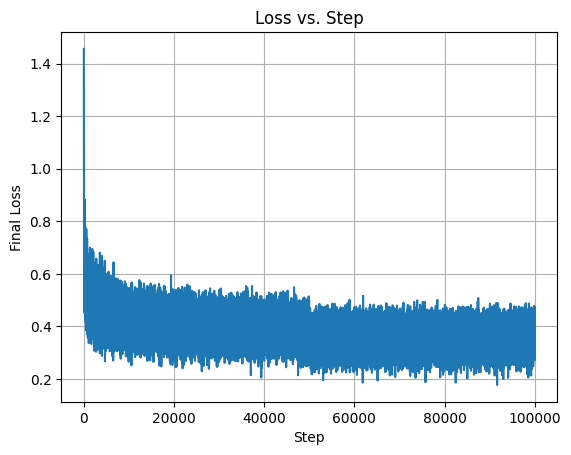

In [73]:
# YOUR CODE GOES HERE
plt.plot(stepi, lossi)
plt.xlabel('Step')
plt.ylabel('Final Loss')
plt.title('Loss vs. Step')
plt.grid(True)
plt.show()

**ANSWER:** We can not achieve this because more complex model might lead to overfit. As we can see loss didnt decrease under 0.2, it is about 2.28 which is almost same as previous model's.

**TODO:** 8b) Why is the loss so noisy, not decreasing monotonically? **(1 point)**

**ANSWER:** Because we are training with-mini Batches. Loss depends on the data in related batches. Unlike the classical method, it does not find the steepest slope, but finds a slope based on the items in the batch.

## 9. Visualization of the Embedding

The training loss is not really decreasing with increased hidden layer. It could be that the bottleneck of the network right now are the embeddings that are twodimensional. Intuitively: We are cramming too many characters into just two dimensions and the neural net is not able to use that space effectively. Let's visualize the embeddings for a better understanding:

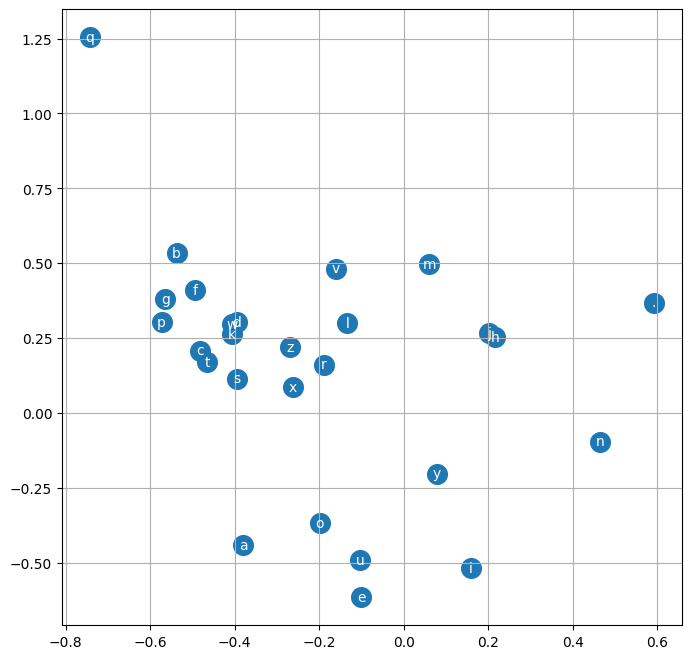

In [74]:
# visualize dimensions 0 and 1 of the embedding matrix C for all characters
plt.figure(figsize=(8,8))
plt.scatter(C[:,0].data, C[:,1].data, s=200)
for i in range(C.shape[0]):
    plt.text(C[i,0].item(), C[i,1].item(), itos[i], ha="center", va="center", color='white')
plt.grid('minor')

**TODO:** 9) Can you interpret the embedding plot? Do you see some structure that the network has learned, or is it purely random - especially compared to our initial plot above? **(2 points)**

**ANSWER:**  We can say that the network has learned some structures. In the first drawing, all the dots were randomly distributed, but in this drawing, some letters became closer because the network noticed that these letters came after each other more often.

## 10. Increasing the Embedding Dimension

**TODO:** 10a) Change the dimension of the embedding to 10 and re-run the training loop. **(2 points)** 

**HINT:** Note that the embedding dimension can be passed as input into `train_loop()`!

In [80]:
# YOUR CODE GOES HERE
g = torch.Generator().manual_seed(42) # for reproducibility
C = torch.randn((27, 10), generator=g)
W1 = torch.randn((30, 300), generator=g)
b1 = torch.randn(300, generator=g)
W2 = torch.randn((300, 27), generator=g)
b2 = torch.randn(27, generator=g)
parameters = [C, W1, b1, W2, b2]

for p in parameters:
    p.requires_grad = True # we want to learn the parameters
    
parameters, stepi, lossi = trainloop(niter, Xtr, Ytr, parameters, lrs,emb_dim=10,output=False)


In [81]:
# evaluate losses on training and dev sets
emb = C[Xtr] # (32, 3, 2)
h = torch.tanh(emb.view(-1, 30) @ W1 + b1) # (32, 100)
logits = h @ W2 + b2 # (32, 27)
loss = F.cross_entropy(logits, Ytr)
print('train loss:', loss)

emb = C[Xdev] # (32, 3, 2)
h = torch.tanh(emb.view(-1, 30) @ W1 + b1) # (32, 100)
logits = h @ W2 + b2 # (32, 27)
loss = F.cross_entropy(logits, Ydev)
print('dev loss:', loss)

train loss: tensor(2.1595, grad_fn=<NllLossBackward0>)
dev loss: tensor(2.2237, grad_fn=<NllLossBackward0>)


Note that we are optimizing the model by hand here for educational purposes - in production, you would create hyperparameters and use grid search for a more systematic search.

**TODO:** 10b) How do you interpret train and dev losses now? **(1 point)**

**ANSWER:** Again, train loss is lower than dev loss which is understandable. Train loss decread compared to previous one with lower embedding dimension. Dev loss also decreased. 

## 11. Final Evaluation and Sampling from the Model

Once we have found a set of promising hyperparameters, we evaluate on the test set *once* and get the final loss to report in a paper for example. Then we can generate new samples using the model:

In [83]:
# sample from the model
g = torch.Generator().manual_seed(42 + 10)

for _ in range(20):
    
    out = []
    context = [0] * block_size # initialize with all ... as context
    while True:
        emb = C[torch.tensor([context])] # (1,block_size,d)
        h = torch.tanh(emb.view(1, -1) @ W1 + b1)
        logits = h @ W2 + b2
        probs = F.softmax(logits, dim=1)
        ix = torch.multinomial(probs, num_samples=1, generator=g).item() # get next index by sampling
        context = context[1:] + [ix] # update context
        out.append(ix) # store the output
        if ix == 0:
            break
    
    print(''.join(itos[i] for i in out))

ellane.
feat.
elyn.
surella.
blau.
jetley.
dalemimo.
maraifina.
jodirukna.
alle.
azer.
kone.
mai.
ana.
avhadan.
laineca.
jhelianavina.
deelaer.
bri.
durellarina.


We see that the output looks a lot more like names now, we are making progress :-)

## 12. Challenge

**TODO (optional):** Try to beat the final validation loss above! Here are some suggestions to further improve the results:

- change the number of neurons in the hidden layer
- change the dimensionality of the embedding lookup table 
- change the number of characters that are feeding in as an input 
- change the details of the optimization: number of iterations, learning rate (decay)... 
- change the batch size 
- read the original paper (you should be able to understand large parts of it now and this paper also has a few ideas for improvements that you can play with)
- ...

Write in the answer cell below what you tried and whether it helped. What is your best validation loss?

**ANSWER:**

In [ ]:
## to be continued...
# Build datasets for each split
block_size = 6
Xtr, Ytr = build_dataset(train_words)
Xdev, Ydev = build_dataset(dev_words)
Xte, Yte = build_dataset(test_words)


g = torch.Generator().manual_seed(42) # for reproducibility
C = torch.randn((27, 100), generator=g)
W1 = torch.randn((600, 60), generator=g)
b1 = torch.randn(60, generator=g)
W2 = torch.randn((60, 27), generator=g)
b2 = torch.randn(27, generator=g)
parameters = [C, W1, b1, W2, b2]

for p in parameters:
    p.requires_grad = True # we want to learn the parameters
    
parameters, stepi, lossi = trainloop(niter, Xtr, Ytr, parameters, lrs,emb_dim=100,output=False,context_length=6)

emb = C[Xtr] # (32, 3, 2)
h = torch.tanh(emb.view(-1, 600) @ W1 + b1) # (32, 100)
logits = h @ W2 + b2 # (32, 27)
loss = F.cross_entropy(logits, Ytr)
print('train loss:', loss)

emb = C[Xdev] # (32, 3, 2)
h = torch.tanh(emb.view(-1, 600) @ W1 + b1) # (32, 100)
logits = h @ W2 + b2 # (32, 27)
loss = F.cross_entropy(logits, Ydev)
print('dev loss:', loss)


sammi
...... ---> s
.....s ---> a
....sa ---> m
...sam ---> m
..samm ---> i
.sammi ---> .
ozymandias
...... ---> o
.....o ---> z
....oz ---> y
...ozy ---> m
..ozym ---> a
.ozyma ---> n
ozyman ---> d
zymand ---> i
ymandi ---> a
mandia ---> s
andias ---> .
power
...... ---> p
.....p ---> o
....po ---> w
...pow ---> e
..powe ---> r
.power ---> .
taraoluwa
...... ---> t
.....t ---> a
....ta ---> r
...tar ---> a
..tara ---> o
.tarao ---> l
taraol ---> u
araolu ---> w
raoluw ---> a
aoluwa ---> .
zymeer
...... ---> z
.....z ---> y
....zy ---> m
...zym ---> e
..zyme ---> e
.zymee ---> r
zymeer ---> .
eivan
...... ---> e
.....e ---> i
....ei ---> v
...eiv ---> a
..eiva ---> n
.eivan ---> .
sudais
...... ---> s
.....s ---> u
....su ---> d
...sud ---> a
..suda ---> i
.sudai ---> s
sudais ---> .
amour
...... ---> a
.....a ---> m
....am ---> o
...amo ---> u
..amou ---> r
.amour ---> .
maizie
...... ---> m
.....m ---> a
....ma ---> i
...mai ---> z
..maiz ---> i
.maizi ---> e
maizie ---> .
ayani
....

In [ ]:
# This cell truncates long output to a maximum length, then converts the notebook to a PDF
# NOTE: You may have to adapt the path or filename to match your local setup

import sys
import os

# Add the parent directory to the sys.path
sys.path.append(os.path.abspath(os.path.join('..')))

# truncate long cell output to avoid large pdf files
from helpers.truncate_output import truncate_long_notebook_output
truncated = truncate_long_notebook_output('2_MLP_Language_Model__student.ipynb')

# convert to pdf with nbconvert
if truncated:
    !jupyter nbconvert --to webpdf --allow-chromium-download TRUNCATED_2_MLP_Language_Model__student.ipynb
else:
    !jupyter nbconvert --to webpdf --allow-chromium-download 2_MLP_Language_Model__student.ipynb